# Mission
Vous êtes consultant pour *Olist*, une entreprise brésilienne qui propose une solution de vente sur les marketplaces en ligne.

**Olist** souhaite que vous fournissiez à ses équipes d'e-commerce une **segmentation des clients** qu’elles pourront utiliser au quotidien pour leurs campagnes de communication.

Votre objectif est de **comprendre les différents types d’utilisateurs** grâce à leur comportement et à leurs données personnelles.

Vous devrez **fournir à l’équipe marketing une description actionable** de votre segmentation et de sa logique sous-jacente pour une utilisation optimale, ainsi qu’une **proposition de contrat de maintenance** basée sur une analyse de la stabilité des segments au cours du temps.

## Les données
Pour cette mission, Olist vous fournit une *base de données* anonymisée comportant des informations sur l’historique de commandes, les produits achetés, les commentaires de satisfaction, et la localisation des clients depuis janvier 2017.

## Votre mission
Votre mission est d’aider les équipes d’Olist à comprendre les différents types d'utilisateurs. Vous utiliserez donc des méthodes non supervisées pour regrouper des clients de profils similaires. Ces catégories pourront être utilisées par l’équipe Marketing pour mieux communiquer.

Vous créez donc un notebook et démarrez votre travail.
# Essais des différentes approches de modélisation
## Import des librairies utilisées

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn import preprocessing
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn import metrics
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.cluster import DBSCAN

## Paramétrages d'affichage

In [2]:
sns.set_theme(style='whitegrid', palette='pastel')

## Import du dataset

In [3]:
data = pd.read_csv('essais.csv', encoding='utf-8')
df = data.copy()
df.head()

,recency,frequency,monetary,review_score,delivery,advance
0,160.0,1.0,141.90,5.0,6.0,4.0
1,163.0,1.0,27.19,4.0,3.0,4.0
2,585.0,1.0,86.22,3.0,25.0,1.0
3,369.0,1.0,43.62,4.0,20.0,11.0
4,336.0,1.0,196.89,5.0,13.0,7.0


## Algorithme du k-means
### Recherche du meilleur clustering
Pour cela, je vais tester 3 configurations :
- dataframe réduit aux seules variables RFM
- dataframe RFM étendu au *review_score*
- dataframe complet

Pour chacune de ces configurations, je ferai varier le nombre de clusters et calculerai les métriques :
- inertie intra cluster
- coefficient de Silhouette
#### Dataframes à tester

In [4]:
df_rfm = df.drop(columns=['review_score', 'delivery', 'advance']).values
df_review = df.drop(columns=['delivery', 'advance']).values
df_full = df.values

#### Normalisation

In [5]:
df_full_std = preprocessing.StandardScaler().fit_transform(df_full)
df_review_std = preprocessing.StandardScaler().fit_transform(df_review)
df_rfm_std = preprocessing.StandardScaler().fit_transform(df_rfm)

#### Nombre de clusters à tester

In [6]:
k_list = range(2, 8)
list(k_list)

[2, 3, 4, 5, 6, 7]

#### Fonction d'entraînement k-means pour chaque *n_clusters*

In [7]:
def train_k_means(data):
    """Return metrics to evaluate best n_clusters for k-means"""
    intertia = []
    silhouettes = []

    for i in k_list:
        kmeans = KMeans(n_clusters=i,
                        n_init=1,
                        init='k-means++',
                        random_state=39)
        kmeans.fit(data)
        intertia.append(kmeans.inertia_)
        silh = metrics.silhouette_score(data, kmeans.labels_)
        silhouettes.append(silh)

    return intertia, silhouettes

#### Récupération des métriques

In [8]:
intertia_rfm, silhouettes_rfm = train_k_means(df_rfm_std)

In [9]:
intertia_review, silhouettes_review = train_k_means(df_review_std)

In [10]:
intertia_full, silhouettes_full = train_k_means(df_full_std)

#### Affichage des résultats

Text(0.5, 0, 'n_cluster')

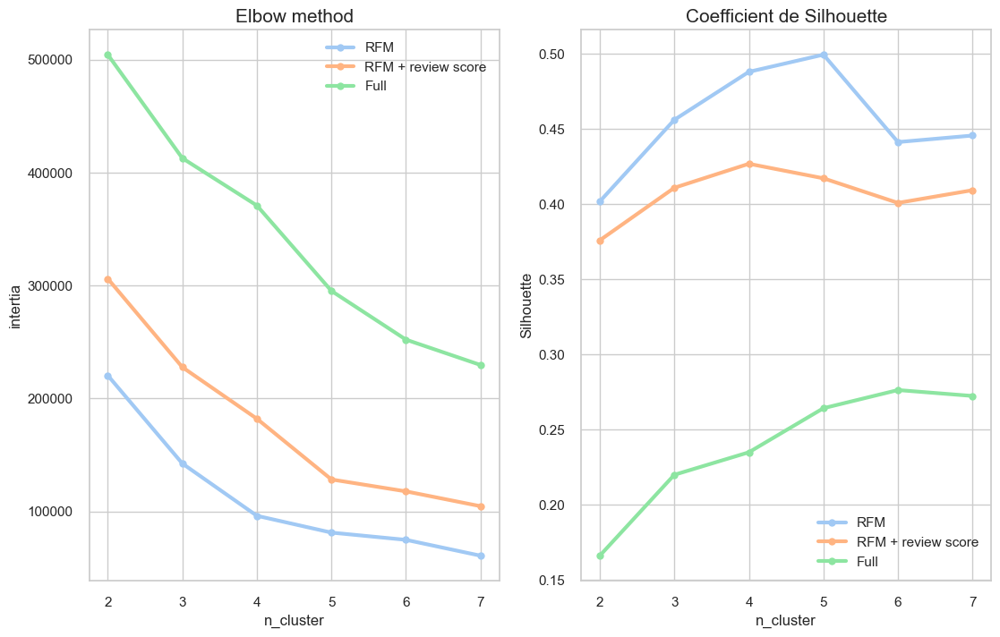

In [11]:
fig = plt.figure(figsize=(13, 8))

ax = fig.add_subplot(121)
ax.plot(k_list, intertia_rfm, marker='o', label='RFM', linewidth=3)
ax.plot(k_list, intertia_review, marker='o',
        label='RFM + review score', linewidth=3)
ax.plot(k_list, intertia_full, marker='o', label='Full', linewidth=3)
ax.legend(loc='upper right')
ax.set_title('Elbow method', fontsize=15)
ax.set_ylabel("intertia")
ax.set_xlabel("n_cluster")

ax = fig.add_subplot(122)
ax.plot(k_list, silhouettes_rfm, marker='o', label='RFM', linewidth=3)
ax.plot(k_list, silhouettes_review, marker='o',
        label='RFM + review score', linewidth=3)
ax.plot(k_list, silhouettes_full, marker='o', label='Full', linewidth=3)
ax.legend(loc='lower right')
ax.set_title('Coefficient de Silhouette', fontsize=15)
ax.set_ylabel("Silhouette")
ax.set_xlabel("n_cluster")

### Choix
Au vu des résultats, il apparaît que **l'ajout de features supplémentaires au RFM de base n'est pas probant**.
L'étude se poursuivra donc avec le dataframe *df_rfm*.

Sur le graphe **Elbow method**, la cassure la plus forte apparaît avec 4 clusters.
En s'intéressant plus particulièrement à ce chiffre +/-1 et en regardant les coefficients de Silhouette associés, le meilleur résultat est donné pour *5 clusters*.

Après avoir testé avec 5 clusters, il s'avère que leur caractérisation est difficile, d'autant plus qu'un cluster compte moins de 500 individus (492 précisément).

Dès lors, je vais privilégier la méthode du coude sur le coefficient de Silhouette et continuer avec **4 clusters**.

### Clusters
Afin d'observer les clusters obtenus, je dois ré-entraîner un estimateur :

In [12]:
X = df.drop(columns=['review_score', 'delivery', 'advance'])
scaler = preprocessing.StandardScaler()
X_scaled = scaler.fit_transform(X)

In [13]:
kmeans = KMeans(n_clusters=4, n_init=1,
                init='k-means++', random_state=39)
kmeans.fit(X_scaled)

KMeans(n_clusters=4, n_init=1, random_state=39)

#### Silhouette Visualizer

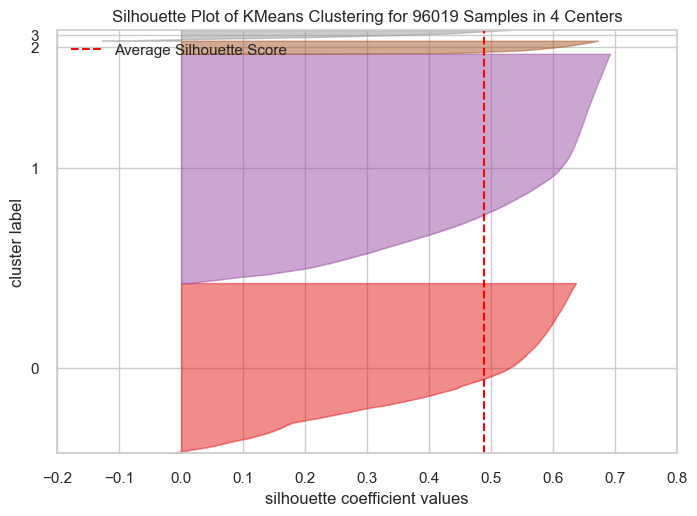

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 96019 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [14]:
visualizer = SilhouetteVisualizer(kmeans)
visualizer.fit(X_scaled)
visualizer.poof()

#### Les clusters :

In [15]:
kmeans.labels_

array([1, 1, 0, ..., 0, 1, 0])

#### Modification des étiquettes

In [16]:
dd = {i: j for i, j in enumerate(list("abcd"))}
dd

{0: 'a', 1: 'b', 2: 'c', 3: 'd'}

In [17]:
labels = [dd[i] for i in kmeans.labels_]
labels[:10]

['b', 'b', 'a', 'a', 'a', 'b', 'b', 'b', 'a', 'b']

#### Ajout des étiquettes au dataframe X

In [18]:
X["cluster"] = labels
X

,recency,frequency,monetary,cluster
0,160.0,1.0,141.90,b
1,163.0,1.0,27.19,b
2,585.0,1.0,86.22,a
3,369.0,1.0,43.62,a
4,336.0,1.0,196.89,a
...,...,...,...,...
96014,495.0,1.0,2067.42,d
96015,310.0,1.0,84.58,a
96016,617.0,1.0,112.46,a
96017,168.0,1.0,133.69,b


#### Décompte des clusters

In [19]:
cluster_repartition = X.groupby('cluster')[['recency', 'frequency']].count()
cluster_repartition['frequency'] = round(
    cluster_repartition['frequency']*100/cluster_repartition['frequency'].sum(), 1)
cluster_repartition.rename(
    columns={'recency': 'Nombre', 'frequency': 'Part (%)'})

,Nombre,Part (%)
cluster,,
a,38623,40.2
b,51993,54.1
c,2961,3.1
d,2442,2.5


Le plus petit cluster compte **2442 clients** ce qui est suffisamment **représentatif**.
#### Boxplots des variables en fonction des clusters

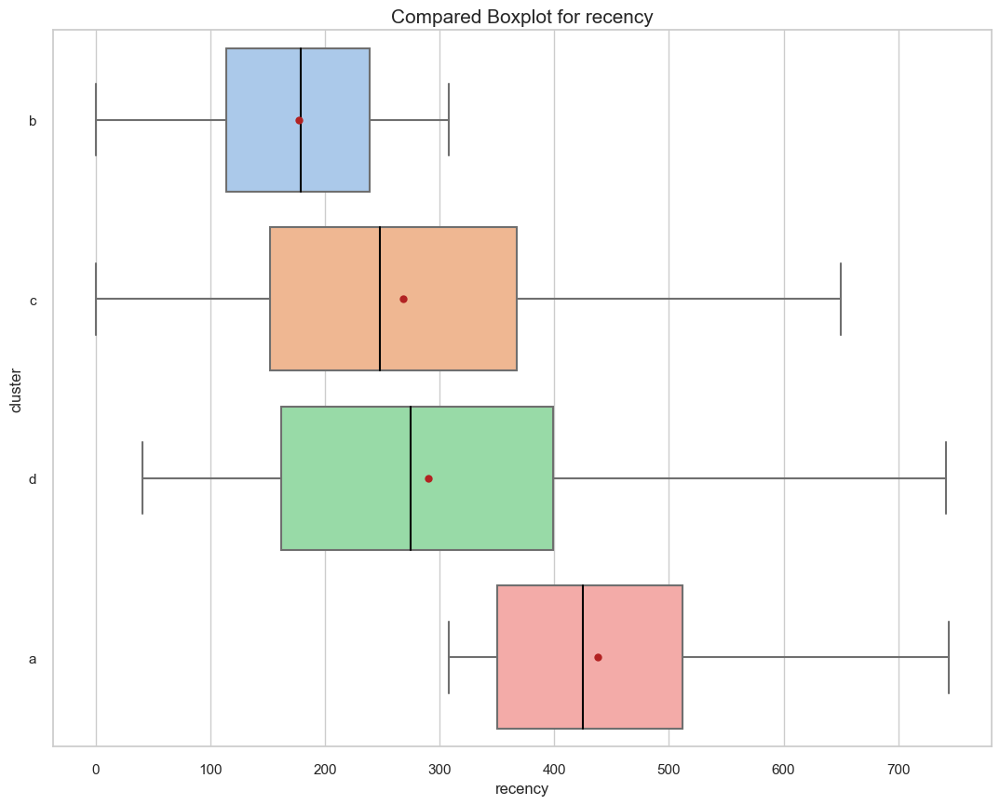

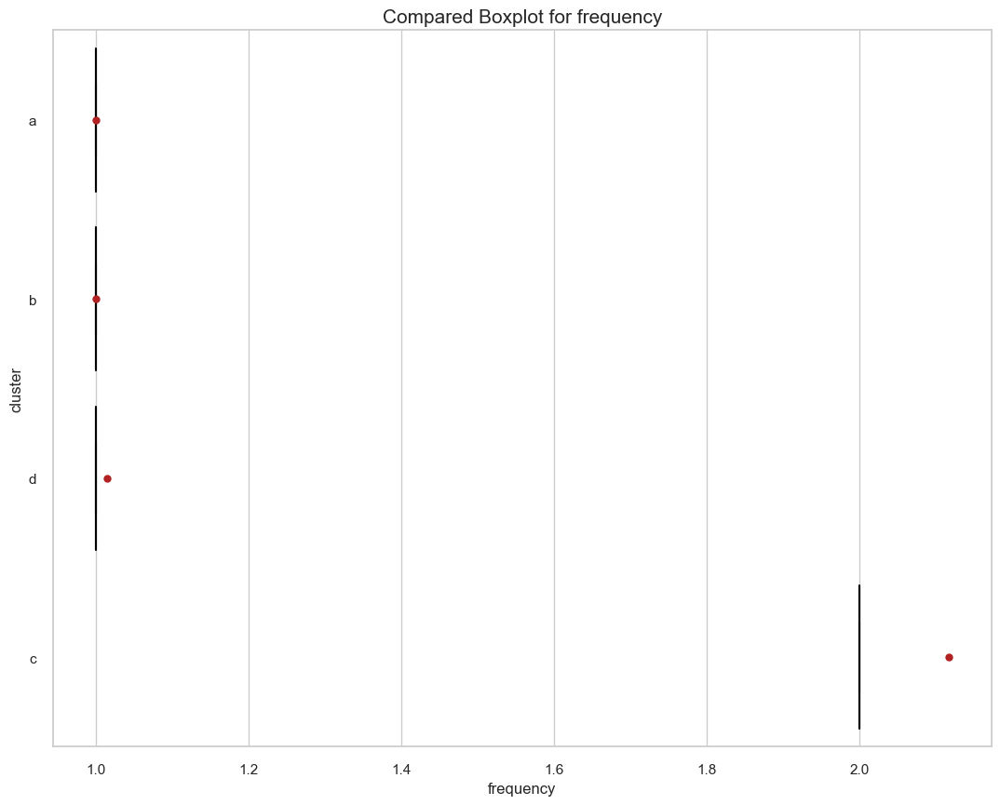

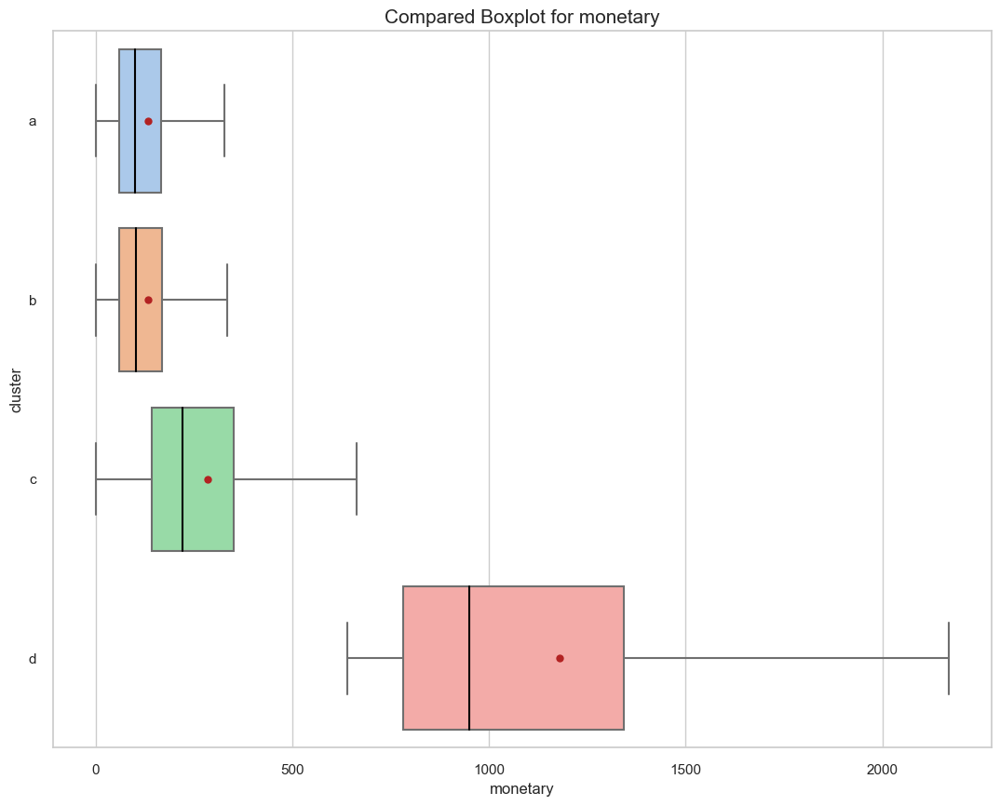

In [20]:
rfm_features = ['recency', 'frequency', 'monetary']


def compared_boxplot(dataframe, features):
    """Compare feature's boxplots for each cluster"""
    for feat in features:
        order = dataframe.groupby('cluster')[feat].mean().sort_values().index
        plt.figure(figsize=(13, 10))
        plt.title('Compared Boxplot for '+str(feat), fontsize=15)
        sns.boxplot(x=feat,
                    y='cluster',
                    showfliers=False,
                    orient='h',
                    order=order,
                    data=dataframe,
                    showmeans=True,
                    meanprops={'marker': 'o',
                               'markeredgecolor': 'black',
                               'markerfacecolor': 'firebrick'},
                    medianprops={'color': "black"})
        plt.show()


compared_boxplot(X, rfm_features)

#### Observation des clusters

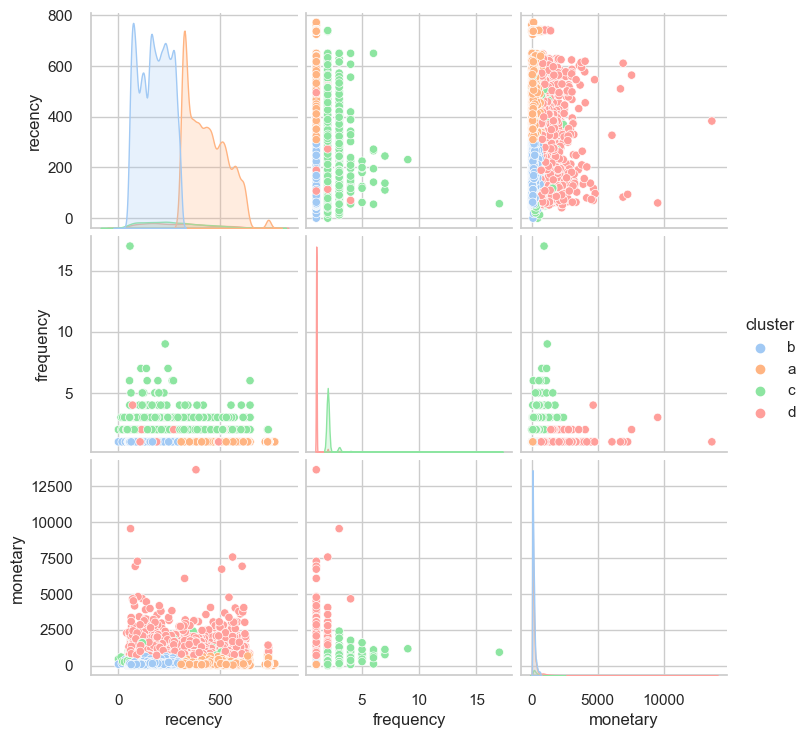

In [21]:
sns.pairplot(X, hue="cluster")

### Centroïdes

In [22]:
centroids = kmeans.cluster_centers_
centroids

array([[ 0.97754579, -0.16237751, -0.13939003],
       [-0.71984247, -0.16237751, -0.13427301],
       [-0.12618211,  5.04488727,  0.52456544],
       [ 0.01457899, -0.09197991,  4.40878554]])

In [23]:
centroids_minmax = MinMaxScaler().fit_transform(centroids)
centroids_minmax = pd.DataFrame(centroids_minmax, columns=rfm_features)
centroids_minmax['cluster'] = ['cluster a',
                               'cluster b', 'cluster c', 'cluster d']
centroids_minmax.set_index('cluster', inplace=True)
centroids_minmax

,recency,frequency,monetary
cluster,,,
cluster a,1.000000,4.163336e-17,0.000000
cluster b,0.000000,0.000000e+00,0.001125
cluster c,0.349749,1.000000e+00,0.145983
cluster d,0.432677,1.351911e-02,1.000000


#### RadarPlot des clusters

In [24]:
fig = go.Figure()
for i in range(0, 4):
    fig.add_trace(go.Scatterpolar(
        r=centroids_minmax.iloc[i, :],
        theta=rfm_features,
        fill='toself',
        name=centroids_minmax.index[i]))
fig.update_layout(polar=dict(radialaxis=dict(
    visible=False, range=[-0.2, 1.2])), showlegend=True)
fig.show()

### Conclusions sur la Segmentation des clients
Pour résumer les 3 types de représentations précédentes, les clients peuvent être répartis en 4 catégories :
- cluster **a** = Anciens clients ponctuels à faible pouvoir d'achat
- cluster **b** = Nouveaux clients à faible pouvoir d'achat
- cluster **c** = Clients fidèles à pouvoir d'achat modéré
- cluster **d** = Clients occasionnels à haut pouvoir d'achat
### ACP pour projection
Une Analyse en Composantes Principales me permettra d'effectuer une projection.

Les données sont déjà normalisées :

In [25]:
X_scaled[:10]

array([[-0.83297586, -0.16237751, -0.09544576],
       [-0.81342395, -0.16237751, -0.59433014],
       [ 1.93687723, -0.16237751, -0.33760322],
       [ 0.52914013, -0.16237751, -0.52287455],
       [ 0.31406919, -0.16237751,  0.14371083],
       [-0.61138761, -0.16237751,  0.01362948],
       [-0.70262983, -0.16237751, -0.55871107],
       [-0.37024746, -0.16237751,  1.11047057],
       [ 1.97598104, -0.16237751, -0.05969622],
       [-0.44845507, -0.16237751, -0.14824374]])

#### ACP

In [26]:
pca = PCA(n_components=3)
pca.fit(X_scaled)

PCA(n_components=3)

#### Variance cumulée

In [27]:
pca.explained_variance_ratio_.cumsum()

array([0.37597604, 0.7086876 , 1.        ])

#### Visualisation

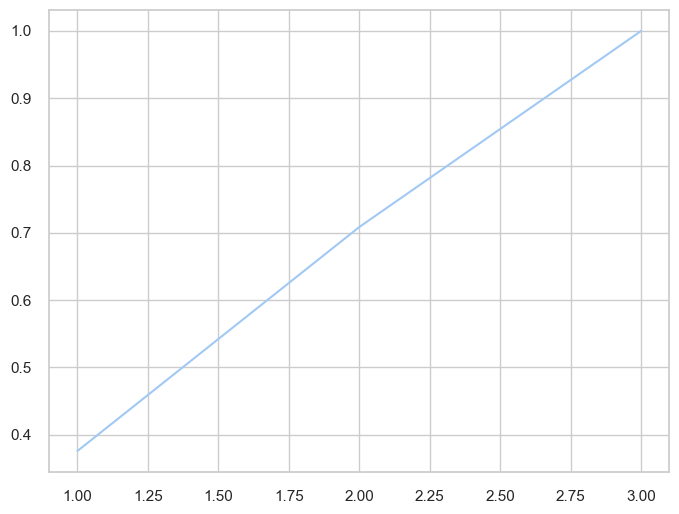

In [28]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, 4), pca.explained_variance_ratio_.cumsum())
plt.show()

#### Coordonnées des individus dans le nouvel espace de projection :

In [29]:
X_proj = pca.transform(X_scaled)
X_proj[:10]

array([[-0.04482463, -0.84086651, -0.1423355 ],
       [-0.39286194, -0.91871586,  0.20706028],
       [-0.66271472,  1.82723576,  0.33742332],
       [-0.56182633,  0.41124992,  0.30818535],
       [-0.06606474,  0.3300505 , -0.17989116],
       [-0.00546537, -0.60243975, -0.19334814],
       [-0.38625989, -0.80318147,  0.19472034],
       [ 0.71351398, -0.15276129, -0.92960007],
       [-0.47696951,  1.91961101,  0.14840761],
       [-0.1438612 , -0.47420113, -0.06238478]])

Je transforme en dataframe avec les composantes en variables :

In [30]:
X_proj = pd.DataFrame(X_proj, columns=["F1", "F2", "F3"])
X_proj[:10]

,F1,F2,F3
0,-0.044825,-0.840867,-0.142336
1,-0.392862,-0.918716,0.207060
2,-0.662715,1.827236,0.337423
3,-0.561826,0.411250,0.308185
4,-0.066065,0.330050,-0.179891
5,-0.005465,-0.602440,-0.193348
6,-0.386260,-0.803181,0.194720
7,0.713514,-0.152761,-0.929600
8,-0.476970,1.919611,0.148408
9,-0.143861,-0.474201,-0.062385


#### Projection des centroïdes :

In [31]:
centroids_proj = pd.DataFrame(centroids,
                              columns=["F1", "F2", "F3"],
                              index=["cluster_0", "cluster_1", "cluster_2", "cluster_3"])
centroids_proj

,F1,F2,F3
cluster_0,0.977546,-0.162378,-0.139390
cluster_1,-0.719842,-0.162378,-0.134273
cluster_2,-0.126182,5.044887,0.524565
cluster_3,0.014579,-0.091980,4.408786


### Visualisations
#### Sur les 3 plans de projections possibles, avec les centroïdes :

Text(0, 0.5, 'F2')

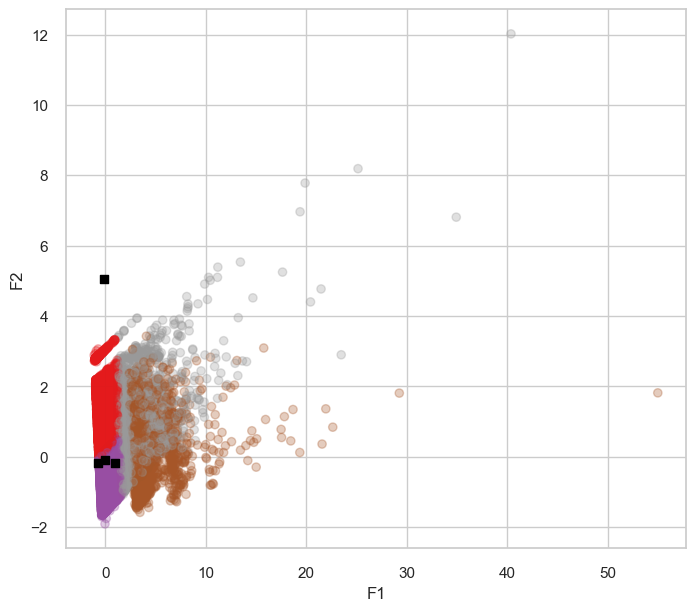

In [32]:
fig, ax = plt.subplots(1, 1, figsize=(8, 7))
ax.scatter(X_proj.iloc[:, 0], X_proj.iloc[:, 1],
           c=kmeans.labels_, cmap="Set1", alpha=0.3)
ax.scatter(centroids_proj.iloc[:, 0],
           centroids_proj.iloc[:, 1],  marker="s", c="black")
ax.set_xlabel("F1")
ax.set_ylabel("F2")

Text(0, 0.5, 'F3')

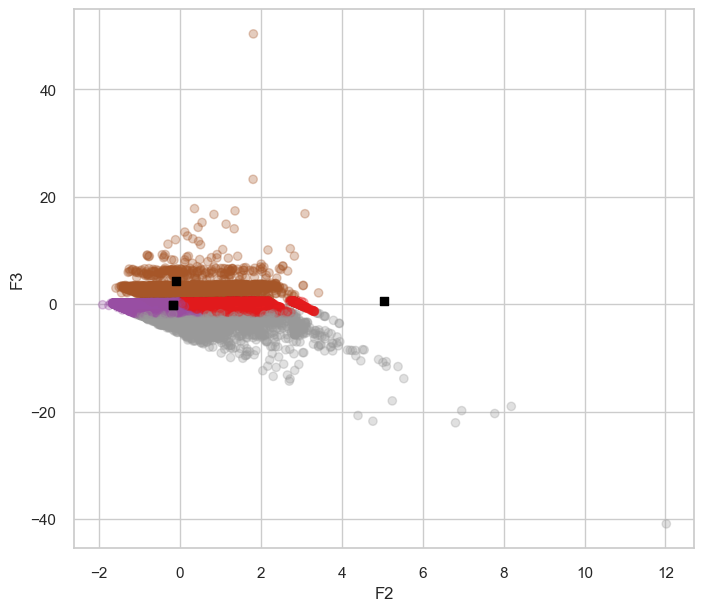

In [33]:
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

ax.scatter(X_proj.iloc[:, 1], X_proj.iloc[:, 2],
           c=kmeans.labels_, cmap="Set1", alpha=0.3)
ax.scatter(centroids_proj.iloc[:, 1],
           centroids_proj.iloc[:, 2],  marker="s", c="black")

ax.set_xlabel("F2")
ax.set_ylabel("F3")

Text(0, 0.5, 'F3')

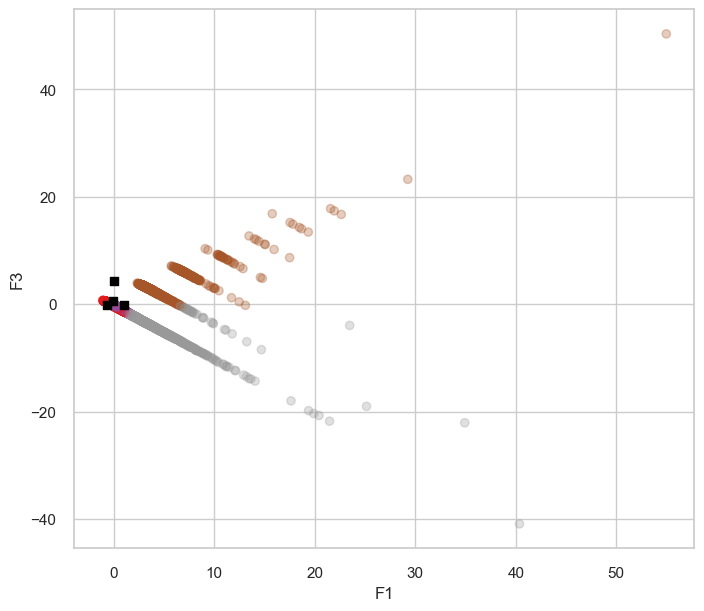

In [34]:
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

ax.scatter(X_proj.iloc[:, 0], X_proj.iloc[:, 2],
           c=kmeans.labels_, cmap="Set1", alpha=0.3)
ax.scatter(centroids_proj.iloc[:, 0],
           centroids_proj.iloc[:, 2],  marker="s", c="black")

ax.set_xlabel("F1")
ax.set_ylabel("F3")

#### En 3 dimensions

Text(0.5, 0, 'F3')

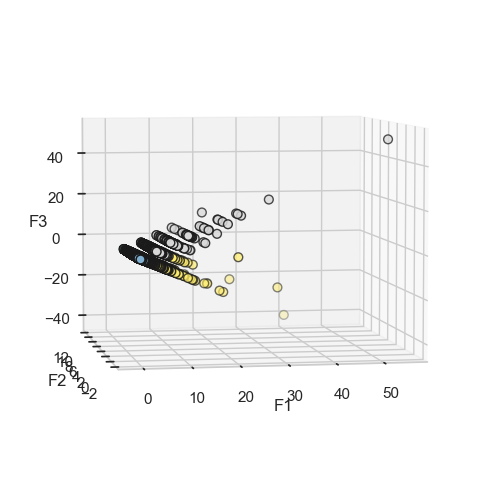

In [35]:
fig = plt.figure(1, figsize=(8, 6))

ax = fig.add_subplot(111, projection="3d", elev=5, azim=-100)
ax.scatter(
    X_proj.iloc[:, 0],
    X_proj.iloc[:, 1],
    X_proj.iloc[:, 2],
    c=kmeans.labels_,
    cmap=plt.cm.Set3,
    edgecolor="k",
    s=40)

ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

#### Toujours en 3D mais manipulable afin de trouver la visualisation donnant la meilleure distinction possible des clusters:

In [36]:
fig = px.scatter_3d(x=X_proj.iloc[:, 0], y=X_proj.iloc[:, 1], z=X_proj.iloc[:, 2],
                    color=kmeans.labels_)
fig.show()

#### Test d'une fonction complète

In [37]:
def display_factorial_planes(X_projected,
                             x_y,
                             pca=None,
                             labels=None,
                             clusters=None,
                             alpha=1,
                             figsize=[10, 8],
                             marker="."):
    """
    Affiche la projection des individus

    Positional arguments : 
    -------------------------------------
    X_projected : np.array, pd.DataFrame, list of list : la matrice des points projetés
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2

    Optional arguments : 
    -------------------------------------
    pca : sklearn.decomposition.PCA : un objet PCA qui a été fit, cela nous permettra d'afficher la variance de chaque composante, default = None
    labels : list ou tuple : les labels des individus à projeter, default = None
    clusters : list ou tuple : la liste des clusters auquel appartient chaque individu, default = None
    alpha : float in [0,1] : paramètre de transparence, 0=100% transparent, 1=0% transparent, default = 1
    figsize : list ou tuple : couple width, height qui définit la taille de la figure en inches, default = [10,8] 
    marker : str : le type de marker utilisé pour représenter les individus, points croix etc etc, default = "."
    """

    # Transforme X_projected en un df
    X_ = pd.DataFrame(X_projected)

    # On définit la forme de la figure si elle n'a pas été donnée
    if not figsize:
        figsize = (7, 6)

    # On vérifie la variable axis
    if not len(x_y) == 2:
        raise AttributeError("2 axes sont demandées")
    if max(x_y) >= X_.shape[1]:
        raise AttributeError("la variable axis n'est pas bonne")

    # On définit x et y
    x, y = x_y

    # Initialisation de la figure
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    # On rajoute la color, les clusters et les labels à X_
    X_["clusters"] = clusters if clusters is not None else "None"
    X_["labels"] = labels if labels is not None else "None"
    c_unique_list = X_["clusters"].sort_values().unique()
    c_dict = {j: i+1 for i, j in enumerate(c_unique_list)}
    X_["colors"] = X_["clusters"].apply(lambda i: c_dict[i])

    # Pour chaque couleur / cluster
    for c in sorted(X_.clusters.unique()):
        # On selectionne le sous DF
        sub_X = X_.loc[X_.clusters == c, :]

        # Clusters and color
        cluster = sub_X.clusters.iloc[0]
        color = sub_X.colors.iloc[0]

        # On affiche les points
        ax.scatter(sub_X.iloc[:, x],
                   sub_X.iloc[:, y],
                   alpha=alpha,
                   label=cluster,
                   cmap="Set1",
                   marker=marker)

    # Si la variable pca a été fournie, on peut calculer le % de variance de chaque axe
    if pca:
        v1 = str(round(100*pca.explained_variance_ratio_[x])) + " %"
        v2 = str(round(100*pca.explained_variance_ratio_[y])) + " %"
    else:
        v1 = v2 = ''

    # Nom des axes, avec le pourcentage d'inertie expliqué
    ax.set_xlabel(f'F{x+1} {v1}')
    ax.set_ylabel(f'F{y+1} {v2}')

    # Valeur x max et y max
    x_max = np.abs(X_.iloc[:, x]).max() * 1.1
    y_max = np.abs(X_.iloc[:, y]).max() * 1.1

    # On borne x et y
    ax.set_xlim(left=-x_max, right=x_max)
    ax.set_ylim(bottom=-y_max, top=y_max)

    # Affichage des lignes horizontales et verticales
    plt.plot([-x_max, x_max], [0, 0], color='grey', alpha=0.8)
    plt.plot([0, 0], [-y_max, y_max], color='grey', alpha=0.8)

    # Affichage des labels des points
    if labels:
        for i, (_x, _y) in enumerate(X_[:, [x, y]]):
            plt.text(_x, _y, labels[i], fontsize='14',
                     ha='center', va='center')

    # Titre, legend et display
    plt.title(f"Projection des individus (sur F{x+1} et F{y+1})")
    if clusters is not None:
        plt.legend()
    plt.show()

C:\Users\Yann\AppData\Local\Temp\ipykernel_13104\3951496171.py:63: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



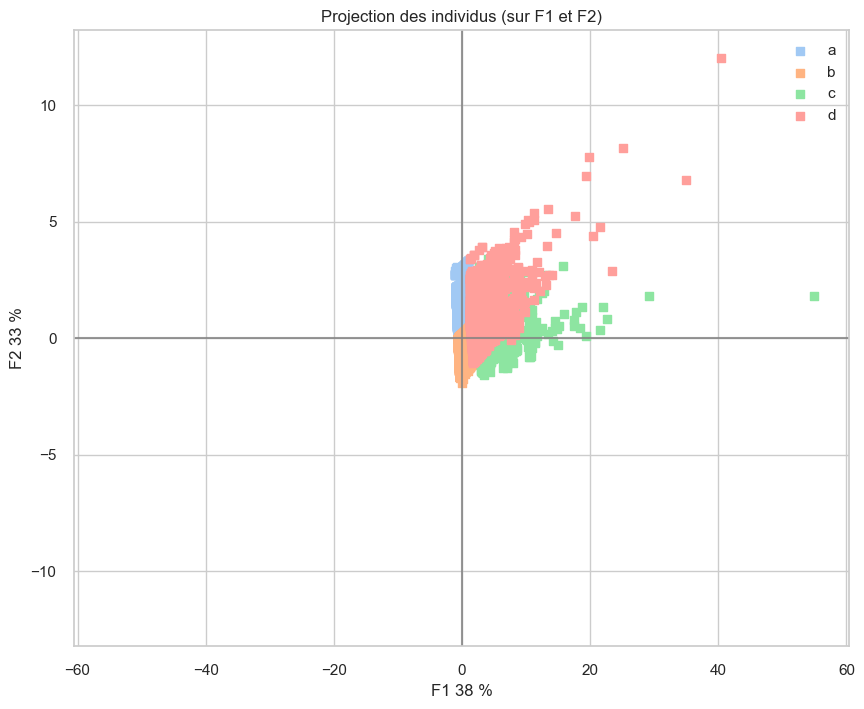

In [38]:
display_factorial_planes(X_proj,  
                         x_y=(0, 1), 
                         clusters=labels, 
                         pca=pca, 
                         figsize=(10, 8), 
                         alpha=1,
                         marker='s')

C:\Users\Yann\AppData\Local\Temp\ipykernel_13104\3951496171.py:63: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



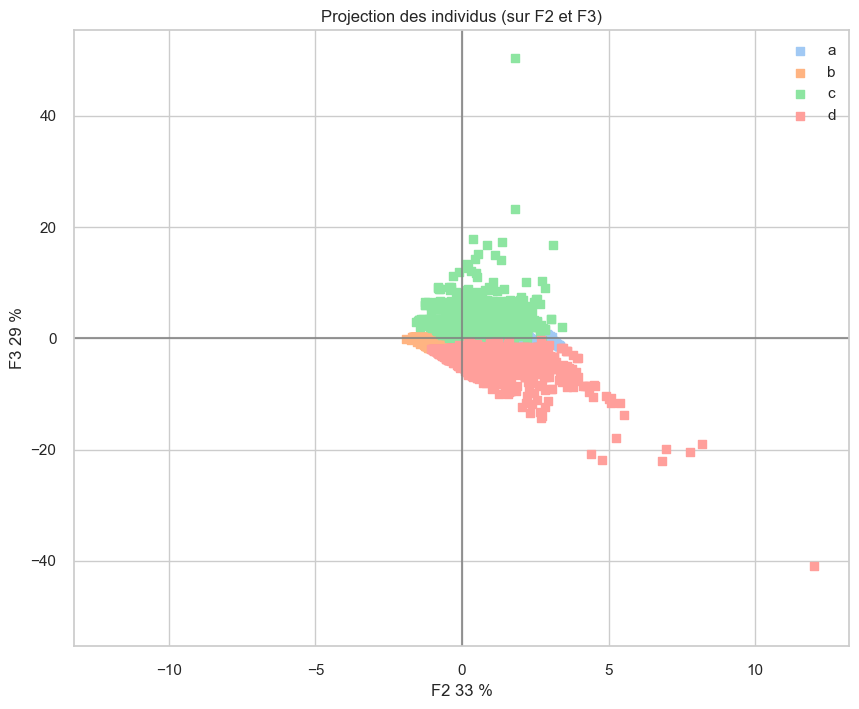

In [39]:
display_factorial_planes(X_proj,  
                         x_y=(1, 2), 
                         clusters=labels, 
                         pca=pca, 
                         figsize=(10, 8), 
                         alpha=1,
                         marker='s')

C:\Users\Yann\AppData\Local\Temp\ipykernel_13104\3951496171.py:63: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



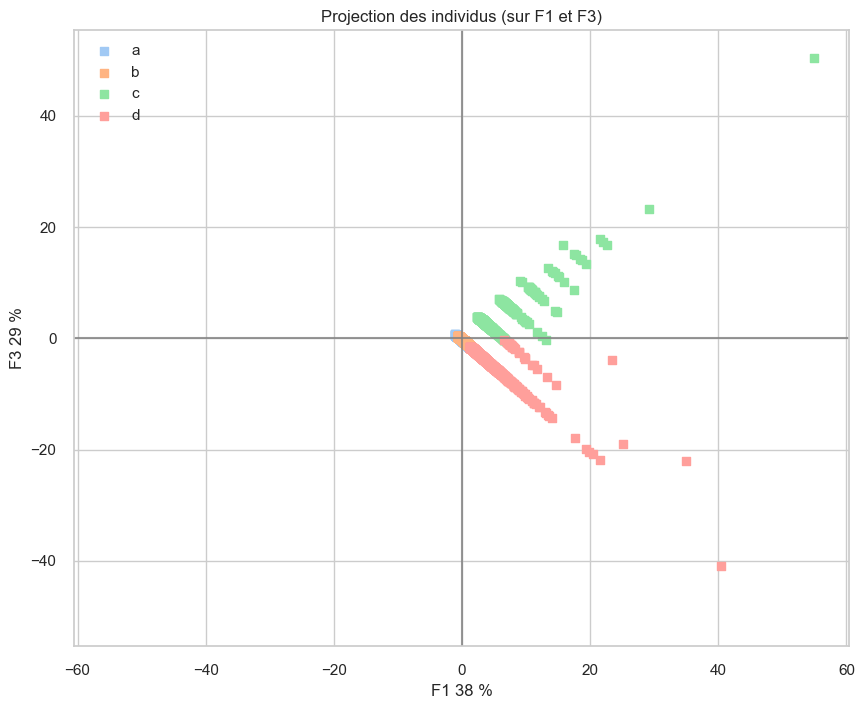

In [40]:
display_factorial_planes(X_proj,  
                         x_y=(0, 2), 
                         clusters=labels, 
                         pca=pca, 
                         figsize=(10, 8), 
                         alpha=1,
                         marker='s')

## Classification Ascendante Hiérarchique
Le clustering hiérarchique étant gourmand en capacités computationnelles, je vais d'abord réaliser un **pré-clustering** avec *KMeans* puis extraire les centroïdes de ces clusters afin de leur appliquer la **CAH**.
### Pré-clustering avec KMeans

In [41]:
kmeans = KMeans(n_clusters=500, n_init=1,
                init='k-means++', random_state=39)
kmeans.fit(X_scaled)

KMeans(n_clusters=500, n_init=1, random_state=39)

### Centroïdes

In [42]:
centroids = kmeans.cluster_centers_
centroids = pd.DataFrame(
    centroids, columns=['recency', 'frequency', 'monetary'])
centroids

,recency,frequency,monetary
0,0.239187,-0.162378,-0.114102
1,-1.084811,4.502891,-0.042696
2,-1.152098,-0.162378,0.066870
3,2.017981,-0.162378,7.527890
4,1.700989,-0.162378,-0.101883
...,...,...,...
495,1.072946,-0.162378,0.035724
496,0.130348,-0.162378,-0.163002
497,-0.378890,4.502891,-0.427467
498,0.257896,-0.162378,5.150251


### Calcul des distances

In [43]:
Z = linkage(centroids, method='ward')
pd.DataFrame(Z)

,0,1,2,3
0,145.0,390.0,0.091047,2.0
1,115.0,288.0,0.092708,2.0
2,67.0,401.0,0.093376,2.0
3,190.0,329.0,0.094110,2.0
4,18.0,345.0,0.095459,2.0
...,...,...,...,...
494,14.0,988.0,69.215280,11.0
495,990.0,992.0,78.988387,413.0
496,991.0,993.0,92.595867,76.0
497,994.0,995.0,123.105911,424.0


### Dendrogrammes

#### Profondeur complète

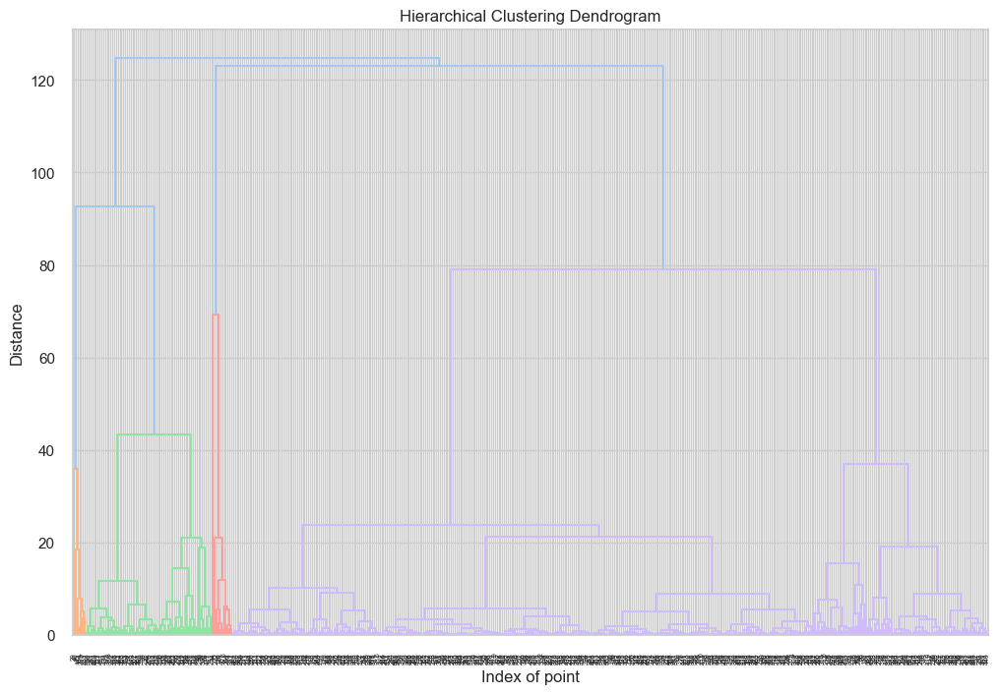

In [44]:
fig, ax = plt.subplots(1, 1, figsize=(12, 8))

_ = dendrogram(Z, ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
ax.set_xlabel("Index of point")
ax.set_ylabel("Distance")
plt.show()

#### Version avec affichage de 4 clusters
Les arguments p=4, truncate_mode="lastp" signifient que l'on ne va afficher que 4 clusters.

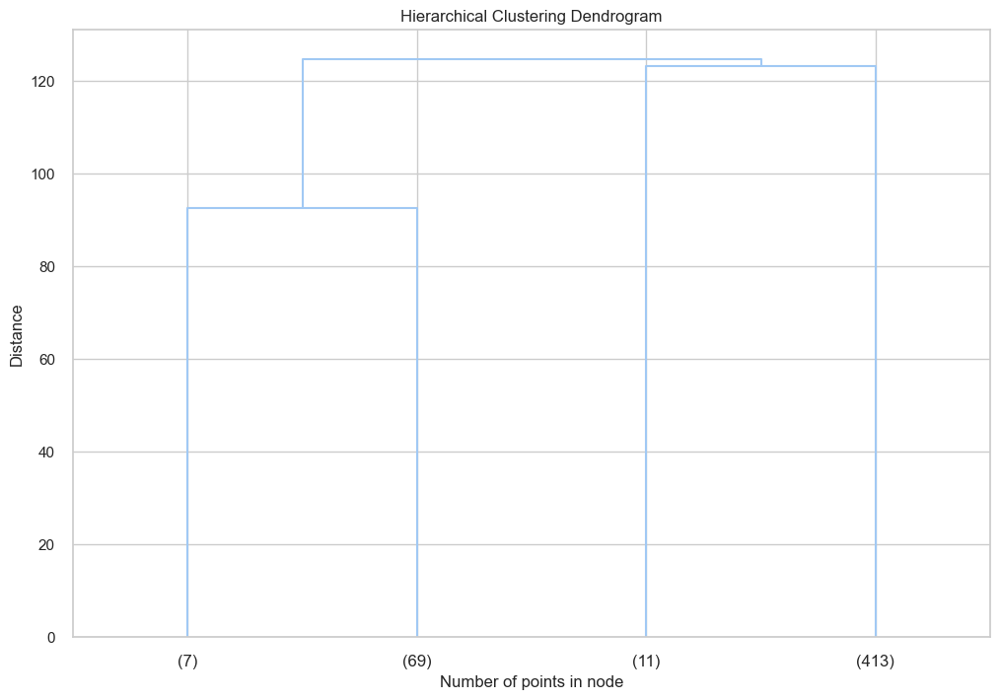

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(12, 8))

_ = dendrogram(Z, p=4, truncate_mode="lastp", ax=ax)

plt.title("Hierarchical Clustering Dendrogram")
ax.set_xlabel("Number of points in node")
ax.set_ylabel("Distance")
plt.show()

## Clusters
### Instancier un estimateur

In [46]:
cah = AgglomerativeClustering(n_clusters=4, linkage='ward')

### Entraîner l'estimateur

In [47]:
cah.fit(centroids)

AgglomerativeClustering(n_clusters=4)

### Etiquettes des clusters
#### Catégories cardinales

In [48]:
cah.labels_

array([0, 0, 0, 1, 0, 0, 2, 3, 0, 0, 0, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 3, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0,
       0, 0, 3, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       3, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 2, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 3, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,

#### Modification des étiquettes

In [49]:
dd = {i: j for i, j in enumerate(list("abcd"))}
labels = [dd[i] for i in cah.labels_]
labels[:10]

['a', 'a', 'a', 'b', 'a', 'a', 'c', 'd', 'a', 'a']

In [50]:
centroids["cluster"] = labels
centroids.head()

,recency,frequency,monetary,cluster
0,0.239187,-0.162378,-0.114102,a
1,-1.084811,4.502891,-0.042696,a
2,-1.152098,-0.162378,0.066870,a
3,2.017981,-0.162378,7.527890,b
4,1.700989,-0.162378,-0.101883,a


### Boxplots des variables en fonction des clusters

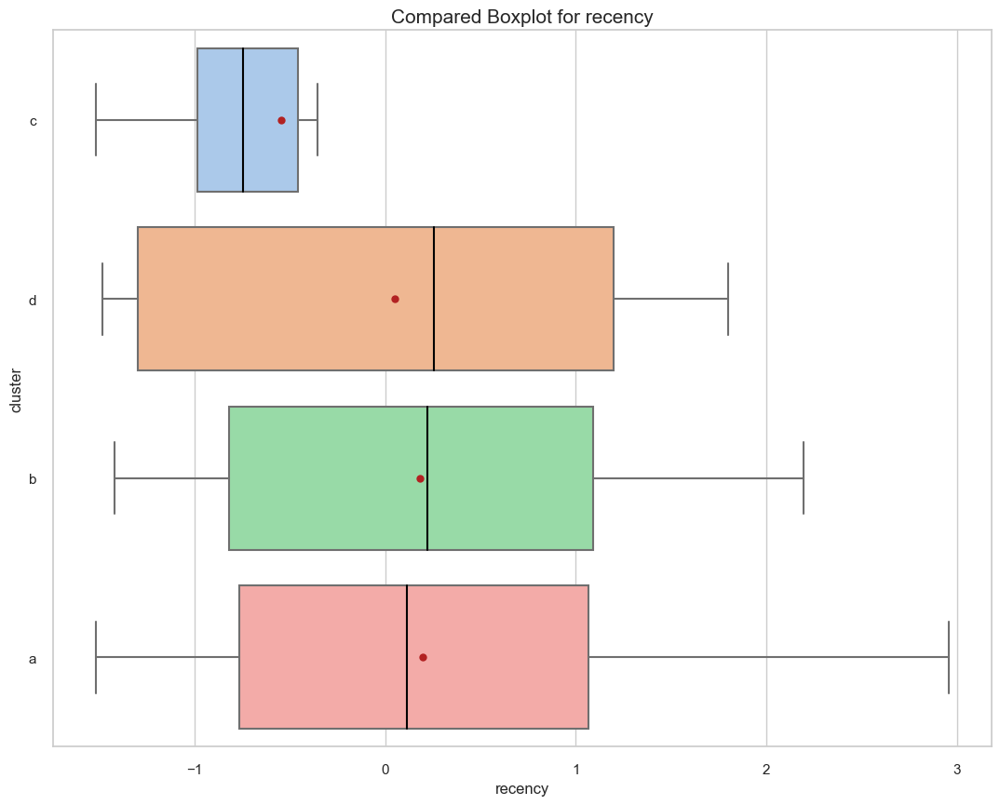

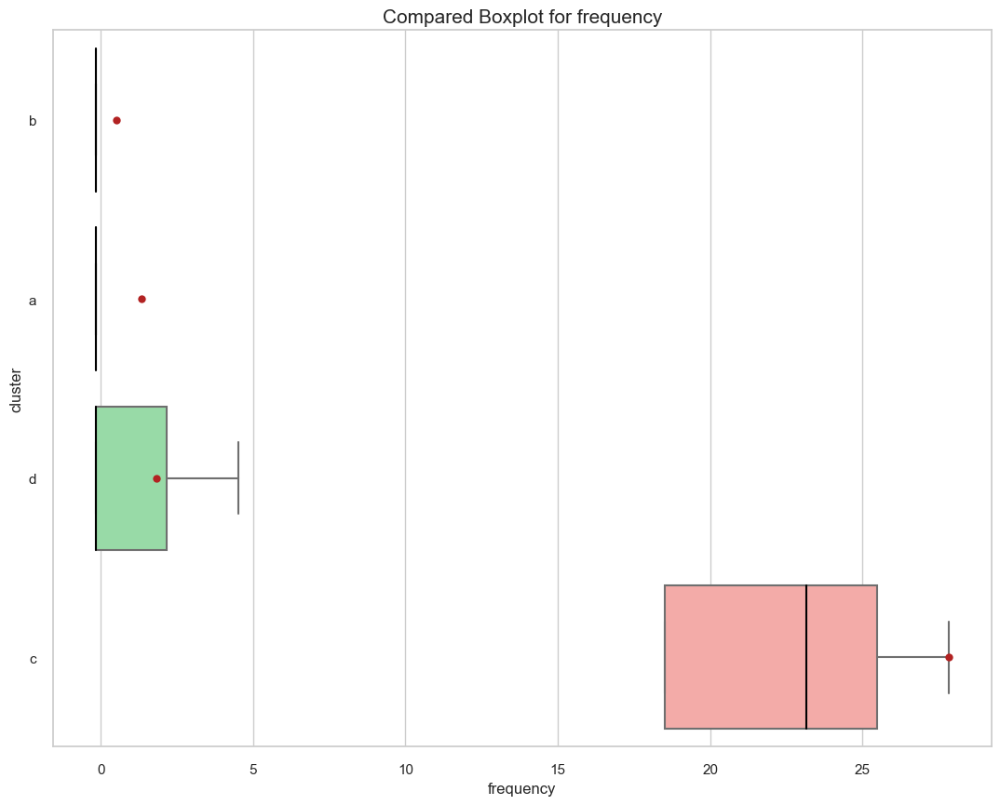

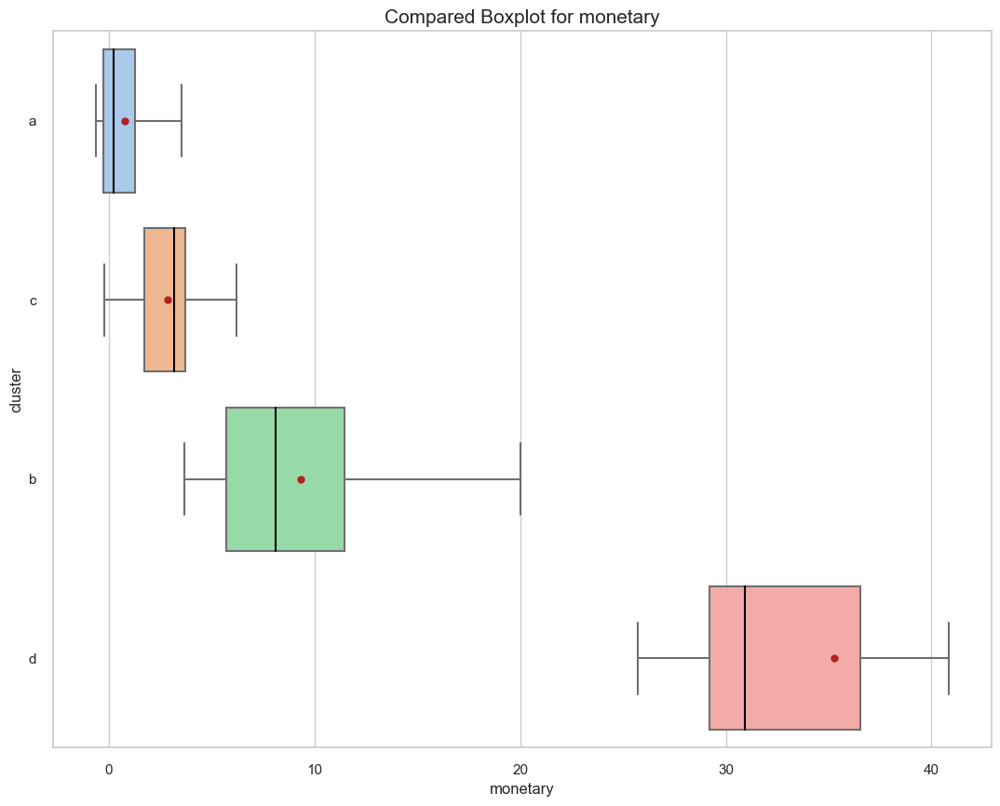

In [51]:
compared_boxplot(centroids, rfm_features)

### Observation des clusters

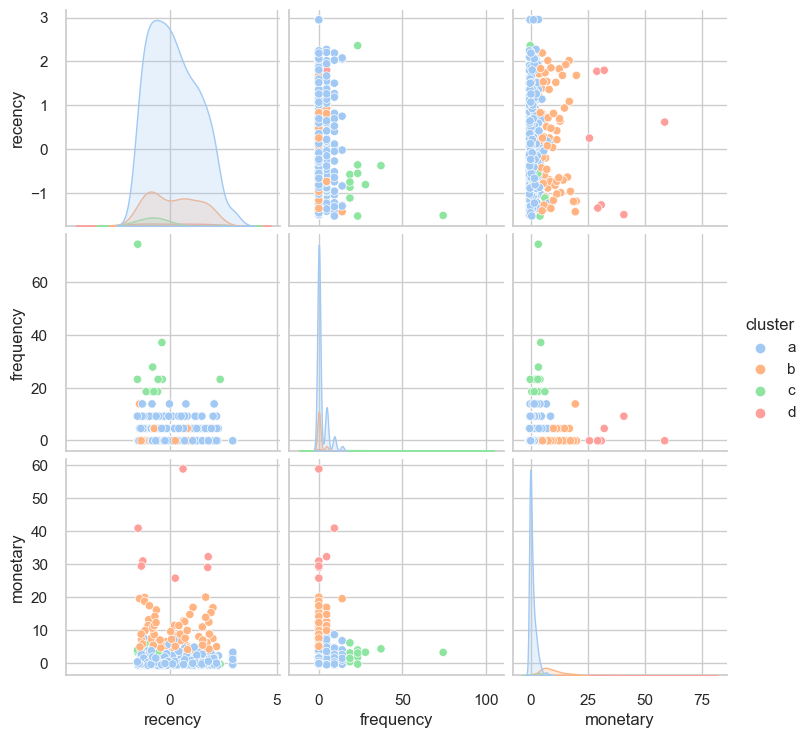

In [52]:
sns.pairplot(centroids, hue='cluster')

 ### Analyse en Composantes Principales

### ACP pour projection
Une Analyse en Composantes Principales me permettra d'effectuer une projection.

Les données sont à normaliser :

In [53]:
X_scaled = preprocessing.StandardScaler().fit_transform(
    centroids.drop(columns=['cluster']))

#### ACP

In [54]:
pca = PCA(n_components=3)
pca.fit(X_scaled)

PCA(n_components=3)

#### Variance cumulée

In [55]:
pca.explained_variance_ratio_.cumsum()

array([0.37886904, 0.7022861 , 1.        ])

#### Visualisation

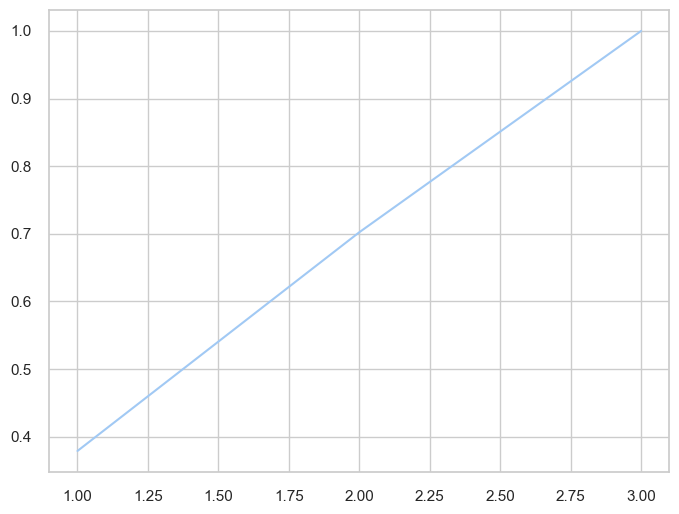

In [56]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, 4), pca.explained_variance_ratio_.cumsum())
plt.show()

#### Coordonnées des individus dans le nouvel espace de projection :

In [57]:
X_proj = pca.transform(X_scaled)
X_proj[:10]

array([[-0.4720545 , -0.31520622, -0.18884617],
       [ 0.83886303, -0.93620958, -0.38029633],
       [ 0.32556041, -0.72727619, -1.04601763],
       [-0.87888613,  1.5088275 ,  0.79830589],
       [-1.29434174,  0.15109001,  0.7089747 ],
       [-0.14756898, -0.03700002, -0.38563276],
       [ 3.74373046, -1.34659471,  2.86039851],
       [ 0.92698262,  4.96722296,  0.35401225],
       [ 0.96064473, -0.32158592,  0.91789213],
       [-0.04266332, -0.55788417, -0.65740166]])

Je transforme en dataframe avec les composantes en variables :

In [58]:
X_proj = pd.DataFrame(X_proj, columns=["F1", "F2", "F3"])
X_proj[:10]

,F1,F2,F3
0,-0.472054,-0.315206,-0.188846
1,0.838863,-0.936210,-0.380296
2,0.325560,-0.727276,-1.046018
3,-0.878886,1.508828,0.798306
4,-1.294342,0.151090,0.708975
5,-0.147569,-0.037000,-0.385633
6,3.743730,-1.346595,2.860399
7,0.926983,4.967223,0.354012
8,0.960645,-0.321586,0.917892
9,-0.042663,-0.557884,-0.657402


### Visualisations

#### En 3 dimensions

Text(0.5, 0, 'F3')

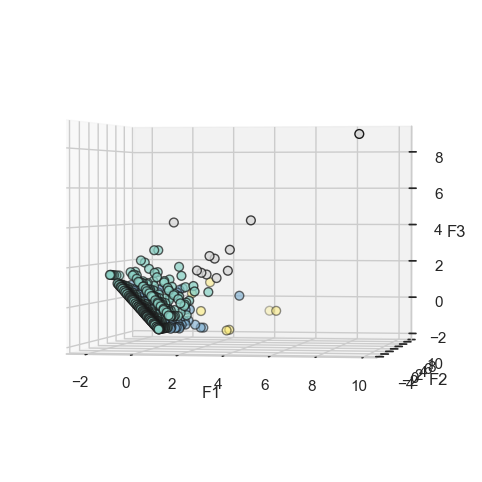

In [59]:
fig = plt.figure(1, figsize=(8, 6))

ax = fig.add_subplot(111, projection="3d", elev=1, azim=-80)
ax.scatter(
    X_proj.iloc[:, 0],
    X_proj.iloc[:, 1],
    X_proj.iloc[:, 2],
    c=cah.labels_,
    cmap=plt.cm.Set3,
    edgecolor="k",
    s=40)

ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

#### Toujours en 3D mais manipulable afin de trouver la visualisation donnant la meilleure distinction possible des clusters:

In [60]:
fig = px.scatter_3d(x=X_proj.iloc[:, 0], y=X_proj.iloc[:, 1], z=X_proj.iloc[:, 2],
                    color=cah.labels_)
fig.show()

#### Projections sur les plans et composantes de l'ACP

C:\Users\Yann\AppData\Local\Temp\ipykernel_13104\3951496171.py:63: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



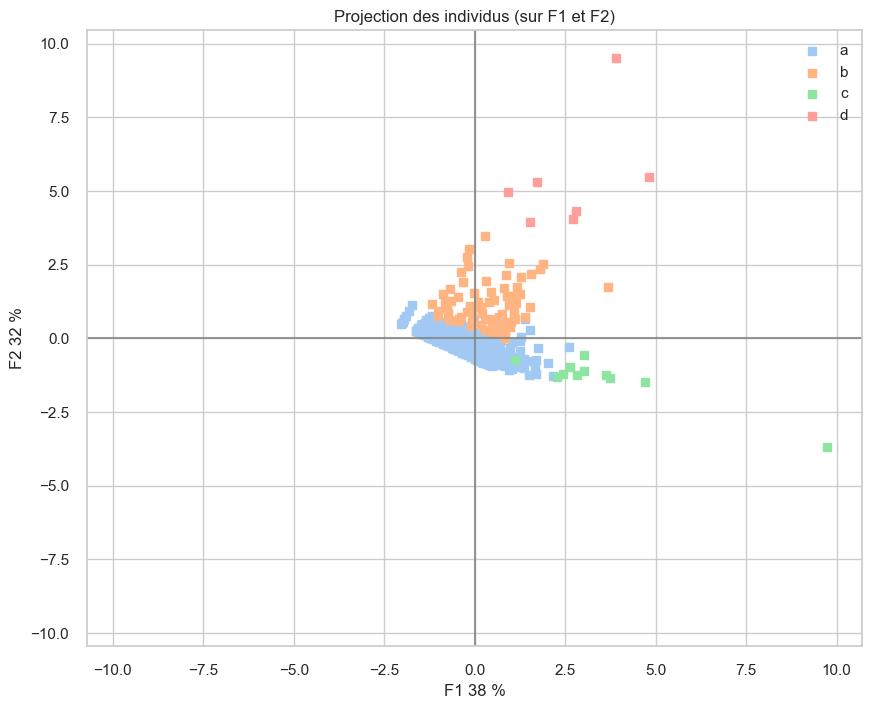

In [61]:
display_factorial_planes(X_proj,
                         x_y=(0, 1),
                         clusters=labels,
                         pca=pca,
                         figsize=(10, 8),
                         alpha=1,
                         marker='s')

C:\Users\Yann\AppData\Local\Temp\ipykernel_13104\3951496171.py:63: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



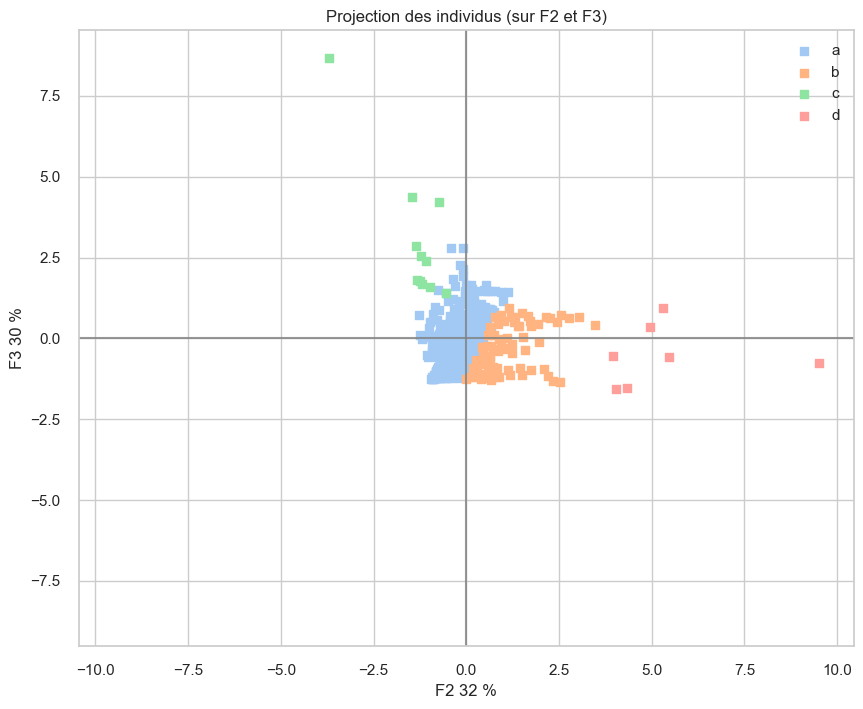

In [62]:
display_factorial_planes(X_proj,  
                         x_y=(1, 2), 
                         clusters=labels, 
                         pca=pca, 
                         figsize=(10, 8), 
                         alpha=1,
                         marker='s')

C:\Users\Yann\AppData\Local\Temp\ipykernel_13104\3951496171.py:63: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



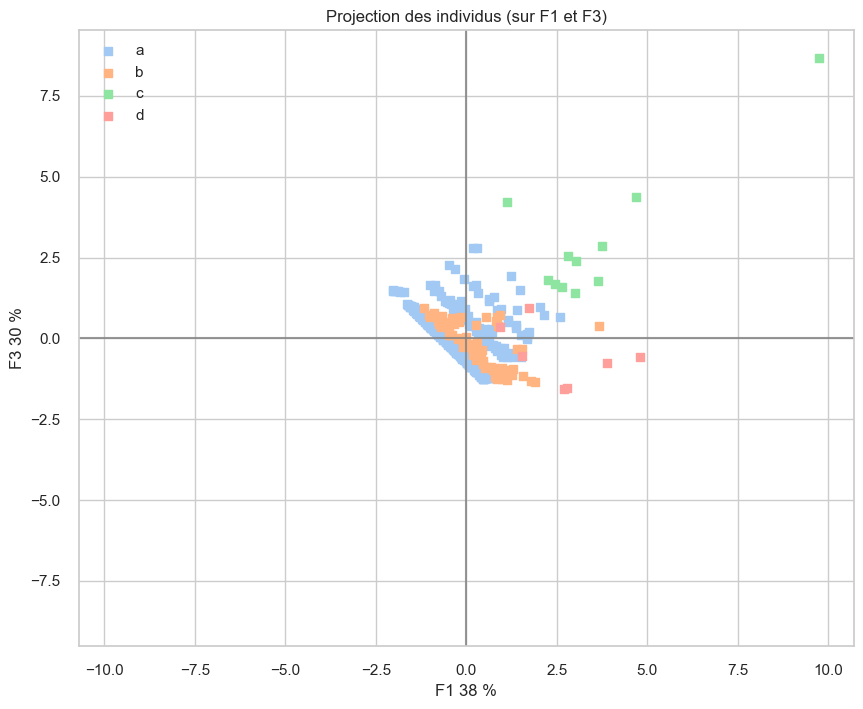

In [63]:
display_factorial_planes(X_proj,  
                         x_y=(0, 2), 
                         clusters=labels, 
                         pca=pca, 
                         figsize=(10, 8), 
                         alpha=1,
                         marker='s')

## DBSCAN
Les données semblent être convexes donc le clustering via DBSCAN ne devrait pas se justifier.

Mais pour le plaisir de tester l'algorithme,... je le fais sur le pré-clustering précédent !

In [64]:
db = DBSCAN(eps=0.3, min_samples=10).fit(X_scaled)
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimation du nombre de clusters: %d" % n_clusters_)
print("Estimation du nombre de points de bruit de fond: %d" % n_noise_)

Estimation du nombre de clusters: 2
Estimation du nombre de points de bruit de fond: 167


Effectivement, DBSCAN ne semble pas très probant.
Je lance tout-de-même une visualisation :

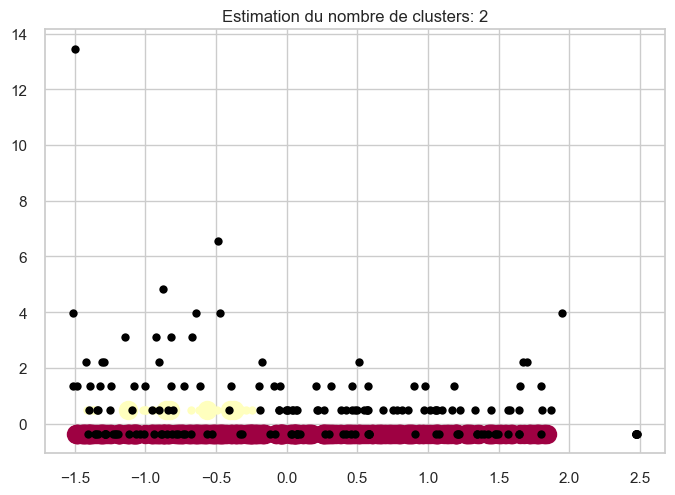

In [65]:
unique_labels = set(labels)
core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True

colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = labels == k

    xy = X_scaled[class_member_mask & core_samples_mask]
    plt.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor="k",
        markersize=14,
    )

    xy = X_scaled[class_member_mask & ~core_samples_mask]
    plt.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor="k",
        markersize=6,
    )

plt.title(f"Estimation du nombre de clusters: {n_clusters_}")
plt.show()